# Import all libraries that are required

In [1]:
import numpy as np 
import pandas as pd 
from PIL import Image
from skimage.color import rgb2gray
import cv2
import cv2 as cv
import os
import matplotlib.pylab as plt

In [2]:
import matplotlib.pyplot as plt
%matplotlib inline
from scipy import ndimage

In [3]:
from facenet_pytorch import MTCNN, InceptionResnetV1
import os
import sys
import random
import math
import numpy as np
import skimage.io
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import glob as glob

In [30]:
from tqdm import tqdm

# Read the video folders and count of number of files in each 

In [4]:
DATA_FOLDER = 'C:/Users/tejru/Downloads/deepfake-detection-challenge'
TRAIN_SAMPLE_FOLDER = 'train_sample_videos'
TEST_FOLDER = 'test_videos'

print(f"Train samples: {len(os.listdir(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER)))}")
print(f"Test samples: {len(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER)))}")

Train samples: 401
Test samples: 400


In [11]:
TRAIN_SAMPLE_FOLDER

'train_sample_videos'

## As we read the video file we need to distinguish the types of content (mp4,Json)

## train_list variable takes all the mp4 files and all of them are seperated

In [8]:
train_list = list(os.listdir(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER)))
ext_dict = []
for file in train_list:
    file_ext = file.split('.')[1]
    if (file_ext not in ext_dict):
        ext_dict.append(file_ext)
print(f"Extensions: {ext_dict}")  

Extensions: ['mp4', 'json']


In [9]:
train_list

['aagfhgtpmv.mp4',
 'aapnvogymq.mp4',
 'abarnvbtwb.mp4',
 'abofeumbvv.mp4',
 'abqwwspghj.mp4',
 'acifjvzvpm.mp4',
 'acqfdwsrhi.mp4',
 'acxnxvbsxk.mp4',
 'acxwigylke.mp4',
 'aczrgyricp.mp4',
 'adhsbajydo.mp4',
 'adohikbdaz.mp4',
 'adylbeequz.mp4',
 'aelfnikyqj.mp4',
 'aelzhcnwgf.mp4',
 'aettqgevhz.mp4',
 'aevrfsexku.mp4',
 'afoovlsmtx.mp4',
 'agdkmztvby.mp4',
 'agqphdxmwt.mp4',
 'agrmhtjdlk.mp4',
 'ahbweevwpv.mp4',
 'ahdbuwqxit.mp4',
 'ahfazfbntc.mp4',
 'ahqqqilsxt.mp4',
 'aipfdnwpoo.mp4',
 'ajqslcypsw.mp4',
 'ajwpjhrbcv.mp4',
 'aklqzsddfl.mp4',
 'aknbdpmgua.mp4',
 'aknmpoonls.mp4',
 'akvmwkdyuv.mp4',
 'akxoopqjqz.mp4',
 'akzbnazxtz.mp4',
 'aladcziidp.mp4',
 'alaijyygdv.mp4',
 'alninxcyhg.mp4',
 'altziddtxi.mp4',
 'alvgwypubw.mp4',
 'amaivqofda.mp4',
 'amowujxmzc.mp4',
 'andaxzscny.mp4',
 'aneclqfpbt.mp4',
 'anpuvshzoo.mp4',
 'aorjvbyxhw.mp4',
 'apatcsqejh.mp4',
 'apgjqzkoma.mp4',
 'apogckdfrz.mp4',
 'aqpnvjhuzw.mp4',
 'arkroixhey.mp4',
 'arlmiizoob.mp4',
 'arrhsnjqku.mp4',
 'asaxgevnnp

# Same with the test folder the mp4 files are separated

In [14]:
TEST_FOLDER

'test_videos'

In [12]:
test_list = list(os.listdir(os.path.join(DATA_FOLDER, TEST_FOLDER)))
ext_dict = []
for file in test_list:
    file_ext = file.split('.')[1]
    if (file_ext not in ext_dict):
        ext_dict.append(file_ext)
print(f"Extensions: {ext_dict}")
for file_ext in ext_dict:
    print(f"Files with extension `{file_ext}`: {len([file for file in train_list if  file.endswith(file_ext)])}")

Extensions: ['mp4']
Files with extension `mp4`: 400


In [13]:
test_list

['aassnaulhq.mp4',
 'aayfryxljh.mp4',
 'acazlolrpz.mp4',
 'adohdulfwb.mp4',
 'ahjnxtiamx.mp4',
 'ajiyrjfyzp.mp4',
 'aktnlyqpah.mp4',
 'alrtntfxtd.mp4',
 'aomqqjipcp.mp4',
 'apedduehoy.mp4',
 'apvzjkvnwn.mp4',
 'aqrsylrzgi.mp4',
 'axfhbpkdlc.mp4',
 'ayipraspbn.mp4',
 'bcbqxhziqz.mp4',
 'bcvheslzrq.mp4',
 'bdshuoldwx.mp4',
 'bfdopzvxbi.mp4',
 'bfjsthfhbd.mp4',
 'bjyaxvggle.mp4',
 'bkcyglmfci.mp4',
 'bktkwbcawi.mp4',
 'bkuzquigyt.mp4',
 'blnmxntbey.mp4',
 'blszgmxkvu.mp4',
 'bnuwxhfahw.mp4',
 'bofrwgeyjo.mp4',
 'btdxnajogv.mp4',
 'bvpeerislp.mp4',
 'bwdmzwhdnw.mp4',
 'bzvzpwrabw.mp4',
 'cekarydqba.mp4',
 'cekwtyxdoo.mp4',
 'cjkctqqakb.mp4',
 'cnpanmywno.mp4',
 'cnxccbjlct.mp4',
 'coqwgzpbhx.mp4',
 'cosghhimnd.mp4',
 'coujjnypba.mp4',
 'cqhwesrciw.mp4',
 'cqxxumarvp.mp4',
 'csnkohqxdv.mp4',
 'cxsvvnxpyz.mp4',
 'czfqlbcfpa.mp4',
 'dcqodpzomd.mp4',
 'ddtbarpcgo.mp4',
 'demuhxssgl.mp4',
 'didzujjhtg.mp4',
 'dkuqbduxev.mp4',
 'dmmvuaikkv.mp4',
 'dnmowthjcj.mp4',
 'doniqevxeg.mp4',
 'dozjwhnedd

# reading json from the train dataset 

In [15]:
json_file = [file for file in train_list if  file.endswith('json')][0]
print(f"JSON file: {json_file}")

JSON file: metadata.json


In [16]:
def get_meta_from_json(path):
    df = pd.read_json(os.path.join(DATA_FOLDER, path, json_file))
    df = df.T
    return df
96.
meta_train_df = get_meta_from_json(TRAIN_SAMPLE_FOLDER)
meta_train_df.head()

,label,split,original
aagfhgtpmv.mp4,FAKE,train,vudstovrck.mp4
aapnvogymq.mp4,FAKE,train,jdubbvfswz.mp4
abarnvbtwb.mp4,REAL,train,None
abofeumbvv.mp4,FAKE,train,atvmxvwyns.mp4
abqwwspghj.mp4,FAKE,train,qzimuostzz.mp4


# Ploting the fake and real content in the train sample

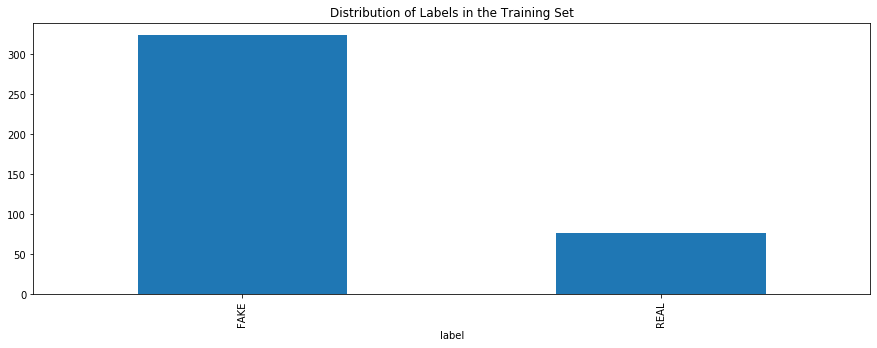

In [17]:
meta_train_df.groupby('label')['label'].count().plot(figsize=(15, 5), kind='bar', title='Distribution of Labels in the Training Set')
plt.show()

# Plot of train video files in the percentage of fake and real videos

In [18]:
def plot_count(feature, title, df, size=1):

    f, ax = plt.subplots(1,1, figsize=(4*size,4))
    total = float(len(df))
    g = sns.countplot(df[feature], order = df[feature].value_counts().index[:20], palette='Set3')
    g.set_title("Number and percentage of {}".format(title))
    if(size > 2):
        plt.xticks(rotation=90, size=8)
    for p in ax.patches:
        height = p.get_height()
        ax.text(p.get_x()+p.get_width()/2.,
                height + 3,
                '{:1.2f}%'.format(100*height/total),
                ha="center") 
    plt.show()    

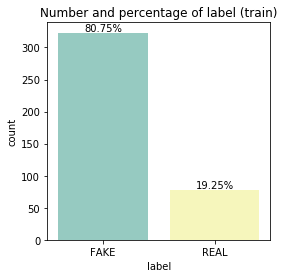

In [22]:
plot_count('label', 'label (train)', meta_train_df)

# Extracting the frame size, Frames per second (fps) and duration of videos

In [32]:
def get_frame_size(file):
    cap = cv2.VideoCapture(file)
    ret, frame = cap.read()
    #plt.imshow(frame)
    shape = frame.shape
    cap.release()
    return shape

def get_video_length(file):
    cap = cv2.VideoCapture(file)
    fps = cap.get(cv2.CAP_PROP_FPS)
    frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    duration = frame_count/fps
    cap.release()
    return round(fps), round(duration)

#  clubing both the classes frame size and fps into a single class extract_metadata

### Where the extract_metadata class function read the video folder and results the fps and duration of all videos.

In [35]:
def extract_metadata(files, path):
    frame_size_list = []
    fps_list = []
    duration_list = []
    for i in tqdm(files):
        shape = get_frame_size(os.path.join(path,f'{i}'))
        fps, duration = get_video_length(os.path.join(path,f'{i}'))
        frame_size_list.append(shape)
        fps_list.append(fps)
        duration_list.append(duration)

    meta_df = pd.DataFrame(data={'frame_shape':frame_size_list, 'fps':fps_list, 'duration':duration_list}, index=files)
    return meta_df

train = os.listdir(os.path.join(DATA_FOLDER, 'train_sample_videos'))
train.remove('metadata.json')
test = os.listdir(os.path.join(DATA_FOLDER, 'test_videos'))

# display of fps, duration of all videos in the train folder

In [42]:
train_meta = extract_metadata(train, os.path.join(DATA_FOLDER, 'train_sample_videos'))
train_meta.head()



  0%|          | 0/400 [00:00<?, ?it/s]

  0%|          | 2/400 [00:00<00:28, 13.87it/s]

  1%|          | 4/400 [00:00<00:27, 14.48it/s]

  2%|▏         | 6/400 [00:00<00:26, 15.05it/s]

  2%|▏         | 8/400 [00:00<00:24, 15.73it/s]

  2%|▎         | 10/400 [00:00<00:25, 15.49it/s]

  3%|▎         | 12/400 [00:00<00:26, 14.53it/s]

  4%|▎         | 14/400 [00:00<00:28, 13.47it/s]

  4%|▍         | 16/400 [00:01<00:27, 14.11it/s]

  4%|▍         | 18/400 [00:01<00:25, 14.80it/s]

  5%|▌         | 20/400 [00:01<00:25, 14.65it/s]

  6%|▌         | 22/400 [00:01<00:25, 14.75it/s]

  6%|▌         | 24/400 [00:01<00:25, 14.65it/s]

  6%|▋         | 26/400 [00:01<00:27, 13.39it/s]

  7%|▋         | 28/400 [00:01<00:26, 14.02it/s]

  8%|▊         | 30/400 [00:02<00:24, 14.93it/s]

  8%|▊         | 32/400 [00:02<00:23, 15.33it/s]

  8%|▊         | 34/400 [00:02<00:23, 15.87it/s]

  9%|▉         | 36/400 [00:02<00:23, 15.58it/s]

 10%|▉         | 38/400 [00:02<00:22, 16.25it/s]

 10%|█     

,frame_shape,fps,duration
aagfhgtpmv.mp4,"(1080, 1920, 3)",30,10
aapnvogymq.mp4,"(1080, 1920, 3)",30,10
abarnvbtwb.mp4,"(1080, 1920, 3)",30,10
abofeumbvv.mp4,"(1080, 1920, 3)",30,10
abqwwspghj.mp4,"(1080, 1920, 3)",30,10


# display of fps, duration of all videos in the test folder

In [44]:
test_meta = extract_metadata(test, os.path.join(DATA_FOLDER, 'test_videos'))
test_meta.head()



  0%|          | 0/400 [00:00<?, ?it/s]

  0%|          | 2/400 [00:00<00:26, 15.14it/s]

  1%|          | 4/400 [00:00<00:25, 15.25it/s]

  2%|▏         | 6/400 [00:00<00:27, 14.36it/s]

  2%|▏         | 8/400 [00:00<00:25, 15.27it/s]

  2%|▎         | 10/400 [00:00<00:25, 15.24it/s]

  3%|▎         | 12/400 [00:00<00:24, 15.82it/s]

  4%|▎         | 14/400 [00:00<00:24, 16.04it/s]

  4%|▍         | 16/400 [00:01<00:22, 16.93it/s]

  4%|▍         | 18/400 [00:01<00:22, 17.27it/s]

  5%|▌         | 20/400 [00:01<00:22, 16.96it/s]

  6%|▌         | 22/400 [00:01<00:22, 17.10it/s]

  6%|▌         | 24/400 [00:01<00:22, 16.80it/s]

  6%|▋         | 26/400 [00:01<00:21, 17.55it/s]

  7%|▋         | 28/400 [00:01<00:21, 17.03it/s]

  8%|▊         | 30/400 [00:01<00:21, 17.24it/s]

  8%|▊         | 32/400 [00:01<00:21, 16.91it/s]

  8%|▊         | 34/400 [00:02<00:22, 16.29it/s]

  9%|▉         | 36/400 [00:02<00:24, 14.74it/s]

 10%|▉         | 38/400 [00:02<00:22, 15.75it/s]

 10%|█     

,frame_shape,fps,duration
aassnaulhq.mp4,"(1080, 1920, 3)",30,10
aayfryxljh.mp4,"(1080, 1920, 3)",30,10
acazlolrpz.mp4,"(1080, 1920, 3)",30,10
adohdulfwb.mp4,"(1080, 1920, 3)",30,10
ahjnxtiamx.mp4,"(1080, 1920, 3)",30,10


# counting the unique values in both train and test datasets

In [46]:
train_meta.frame_shape.value_counts()

(1080, 1920, 3)    375
(1920, 1080, 3)     25
Name: frame_shape, dtype: int64

In [47]:
test_meta.frame_shape.value_counts()

(1080, 1920, 3)    326
(1920, 1080, 3)     74
Name: frame_shape, dtype: int64

# conclude: Videos are in 2 frame sizes: 1080 X 1920 and 1920 X 1080

In [48]:
train_meta.fps.value_counts()

30    400
Name: fps, dtype: int64

In [49]:
test_meta.fps.value_counts()

30    400
Name: fps, dtype: int64

# conclude: All videos are of 10 seconds and in 30 fps

In [57]:
meta_train_df.label=='FAKE'

aagfhgtpmv.mp4     True
aapnvogymq.mp4     True
abarnvbtwb.mp4    False
abofeumbvv.mp4     True
abqwwspghj.mp4     True
                  ...  
etejaapnxh.mp4     True
etmcruaihe.mp4     True
etohcvnzbj.mp4     True
eudeqjhdfd.mp4    False
eukvucdetx.mp4     True
Name: label, Length: 400, dtype: bool

# A sample of three fake videos are taken from train dataset

In [50]:
fake_train_sample_video = list(meta_train_df.loc[meta_train_df.label=='FAKE'].sample(3).index)
fake_train_sample_video

['ebeknhudxq.mp4', 'dgmevclvzy.mp4', 'eprybmbpba.mp4']

# reading images from the videos through opencv (computer vision) library

In [51]:
def display_image_from_video(video_path):

    capture_image = cv2.VideoCapture(video_path) 
    ret, frame = capture_image.read()
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    ax.imshow(frame)

# displaying the fake images from the fake videos

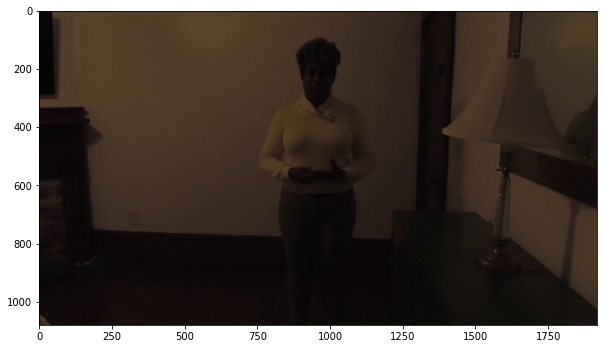

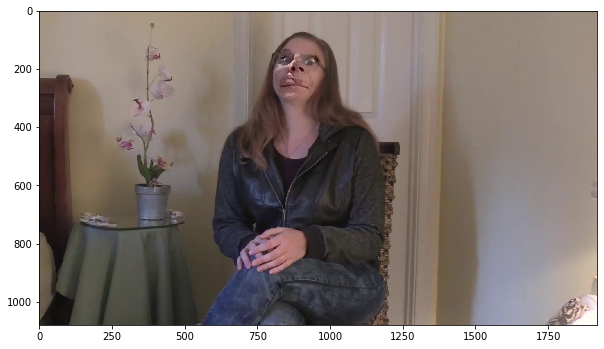

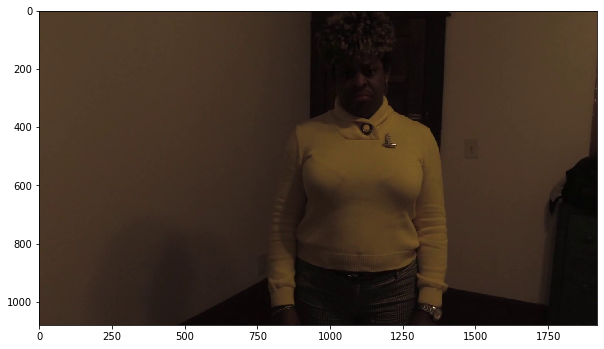

In [55]:
for video_file in fake_train_sample_video:
    display_image_from_video(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER, video_file))

# A sample of three real videos are taken from train dataset

In [58]:
real_train_sample_video = list(meta_train_df.loc[meta_train_df.label=='REAL'].sample(3).index)
real_train_sample_video

['cfxkpiweqt.mp4', 'dkzvdrzcnr.mp4', 'atvmxvwyns.mp4']

# displaying the real images from the real videos

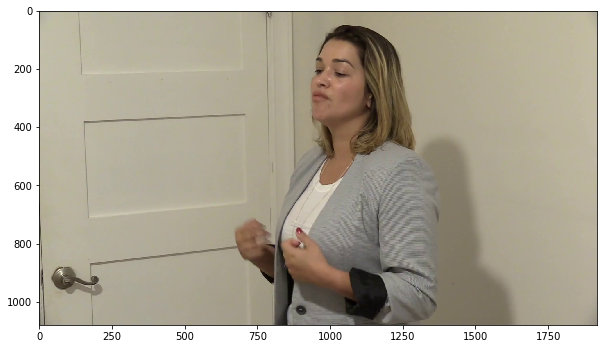

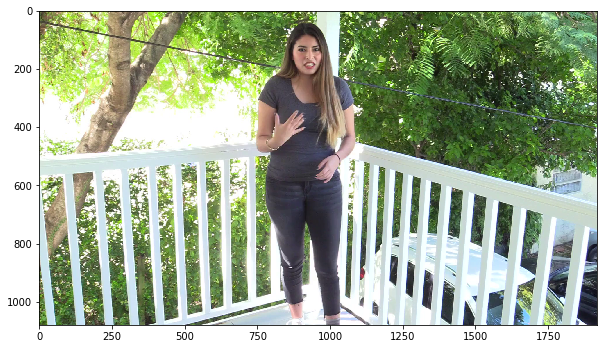

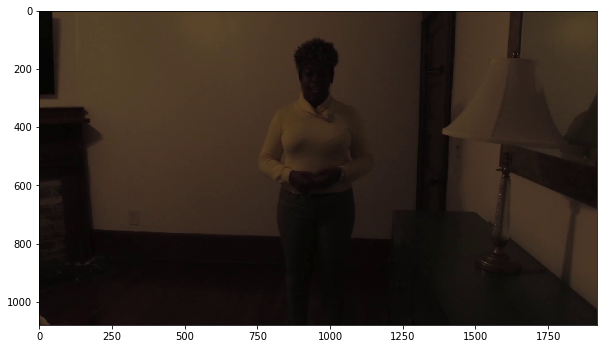

In [59]:
for video_file in real_train_sample_video:
    display_image_from_video(os.path.join(DATA_FOLDER, TRAIN_SAMPLE_FOLDER, video_file))

# display of fake video from the train dataset

In [60]:
fake_videos = list(meta_train_df.loc[meta_train_df.label=='FAKE'].index)

In [61]:
from IPython.display import HTML
from base64 import b64encode

def play_video(video_file, subset=TRAIN_SAMPLE_FOLDER):
    video_url = open(os.path.join(DATA_FOLDER, subset,video_file),'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(video_url).decode()
    return HTML("""<video width=500 controls><source src="%s" type="video/mp4"></video>""" % data_url)

# few samples of fake videos are extracted from the dataset through indexing

In [64]:
play_video(fake_videos[10])

In [66]:
play_video(fake_videos[6])

In [67]:
real_videos = list(meta_train_df.loc[meta_train_df.label=='REAL'].index)

In [68]:
play_video(real_videos[6])

In [72]:
play_video(real_videos[17])